In [41]:
%matplotlib inline
%config InlineBackend.figure_formats = ['svg']

import matplotlib
matplotlib.rcParams['font.sans-serif'] = "Arial"
# matplotlib.rcParams['figure.dpi'] = 80
# matplotlib.rcParams['figure.figsize'] = [12, 6]
matplotlib.rcParams['axes.grid'] = True

In [18]:
%load_ext autoreload
%autoreload 2

import sys
sys.version_info

import sys
sys.path.insert(0, '../')


import numpy as np
import matplotlib.pyplot as plt

from lib_data import *

import random

from tqdm import tqdm
from lib_lsh import *

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [22]:
load_workspace(vars(), filename='data/25shot_may18')
load_workspace(vars(), filename='data/20200619-172822-lsh-hardware-g-5-qs_hash')

Loaded: mem_vals, mem_keys, x, y, x_new, y_new, qs, qs_new, 
Loaded: In, Out, mem_vals, mem_keys, x, y, x_new, y_new, qs, qs_new, hash_planes, hash_key, y_true, y_preds, i, qq, yy, q_hash, distance, g, q, qs_input, rand_vecs, vec_pos, vec_neg, out_pos, out_neg, output, g_true, output_soft, output_soft2, c, lin_cor_lsh, output_cor, qs_hash_new, qs_hash, 


In [23]:
load_workspace(vars(), filename='data/20200620-152651-tcam_experiment_0620n-2')

# from scipy.io import loadmat
# d = loadmat('data/20200620-152651-tcam_experiment_0620n-2.mat')

Loaded: In, Out, mem_vals, mem_keys, x, y, x_new, y_new, qs, qs_new, hash_planes, hash_key, y_true, y_preds, qq, yy, q_hash, distance, g, q, qs_input, rand_vecs, vec_pos, vec_neg, out_pos, out_neg, output, g_true, output_soft, output_soft2, c, lin_cor_lsh, output_cor, qs_hash_new, qs_hash, gdiff, inp, res_dpe, Gtarget, Msel, data, g_hash, inp_new, out_dpe, lin_cor_tcam, idx, n, out_dpe_new, output_cor_new, 


In [24]:
# print('Loading: ', end=' ')
# for k in d.keys():
#     vars()[k] = d[k]b
#     print(k, end=', ')

In [25]:
(mem_vals)

array([ 1,  3,  2, 16, 10,  0,  3, 10, 23, 16, 21,  4, 15, 14,  0, 11, 15,
        0,  5,  5, 20,  6,  7,  0,  0,  8, 10, 11,  8, 13, 22, 18,  0, 16,
       14,  7, 23, 19, 13,  2,  0,  7, 16, 17, 19, 24, 20,  9, 12,  5,  7,
       14, 20,  8, 14,  1, 17, 13, 24, 25,  2,  9, 14, 24])

In [26]:
# from dpe import DPE

# dpe = DPE('COM9')
# dpe.set_clock(50)

def lin_corr(outputs, factors):
    result = np.zeros(outputs.shape)
    for c in range(outputs.shape[1]):
        result[:,c] = outputs[:,c] * factors[c][0] + factors[c][1]

    return result

In [30]:
output_cor = lin_corr(out_dpe, lin_cor_tcam)
idx = output_cor.argmin(axis=1)

y_true = []
y_preds= []

for n, (i, yy )in enumerate(zip(idx, y)):
    if n<125:
        continue
    
    y_pred = mem_vals[i]
    
    y_preds.append(y_pred)
    y_true.append(yy[0])
    
y_true = np.array(y_true)
y_preds= np.array(y_preds)

print(np.mean(y_true==y_preds))

0.808


In [31]:
plt.figure(figsize=(4,3))

for c in range(output.shape[1]):
    plt.plot(output_soft[:,c], output_cor[:,c], '.')
    
plt.xlabel('Expected output')
plt.ylabel('Hardware output')

Text(0, 0.5, 'Hardware output')

In [33]:
output_cor_new = lin_corr(out_dpe_new, lin_cor_tcam)

idx = output_cor_new.argmin(axis=1)

y_true = []
y_preds= []

for n, (i, yy) in enumerate(zip(idx, y_new)):
    if n==1:
        continue
        
    y_pred = mem_vals[i]
    
    y_preds.append(y_pred)
    y_true.append(yy[0])
    
y_true = np.array(y_true)
y_preds= np.array(y_preds)

print(np.mean(y_true==y_preds))

0.8947368421052632


In [34]:
y_preds

array([25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 25, 22,
       22, 25])

In [20]:
def hamming(vec, matrix):
    
    vec = np.expand_dims(vec, 0)
    vec_matrix = np.tile(vec, [np.shape(matrix)[0], 1])
    
    res = np.logical_xor(vec_matrix, matrix)
    hamming = np.sum(res, axis=1)
    
    return hamming

In [37]:
# y_true = []
# y_preds= []

# for i, (qq, yy) in tqdm(enumerate(zip(qs_new, y_new)), total=len(y_new)):
#     if i==0:
#         continue
    
#     q_hash = get_lsh_dpe(qq).reshape(-1)
    
#     distance  = hamming(q_hash, hash_key)
#     y_pred = mem_vals[distance.argmin()]
    
# #     similarities = normalized_query @ mem_keys.T
# #     y_pred = mem_vals[similarities.argmax()]
    
#     y_preds.append(y_pred)
#     y_true.append(yy[0])
    
# y_true = np.array(y_true)
# y_preds= np.array(y_preds)

dist = np.array([hamming(q, hash_key) for q in qs_hash_new])

In [40]:
dist.argmin(axis=1)

array([59, 59, 59, 59, 59, 59, 59, 59, 59, 59, 59, 59, 59, 59, 59, 59, 59,
       30, 30, 59])

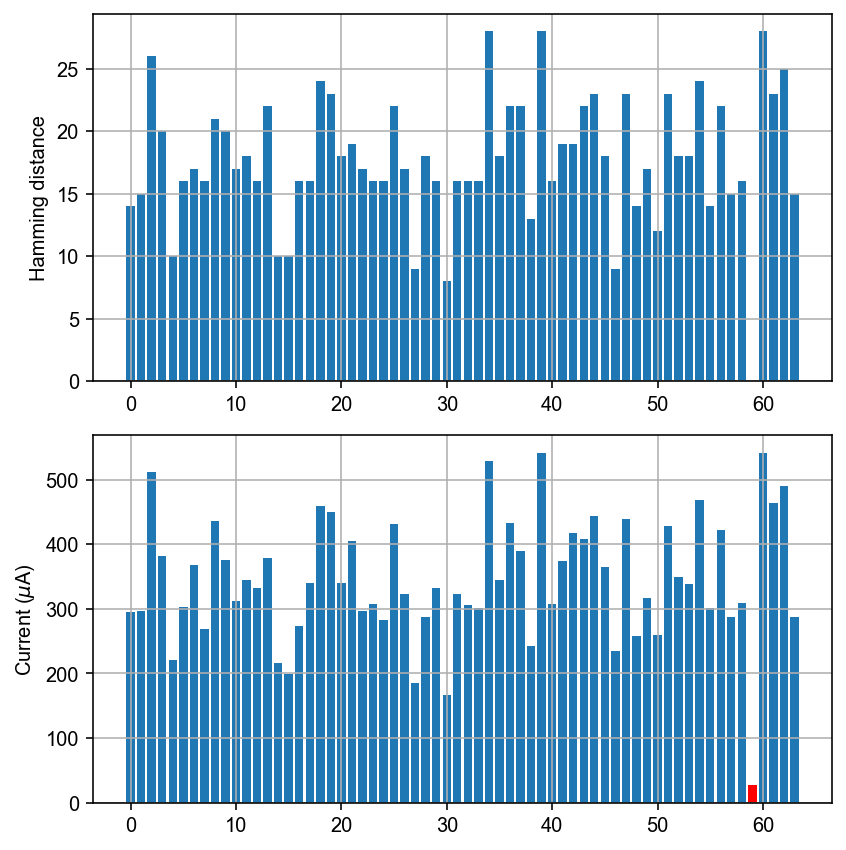

In [88]:
i = 0
fsize = (6,6)
output_curr = output_cor_new * 0.2 * 1e6

plt.figure(figsize=fsize)
plt.subplot(2,1,1)

# plt.figure(1, figsize=fsize)
plt.bar(range(64), dist[i])
plt.bar(dist[i].argmin(), dist[i].min(), color='red')
plt.ylabel('Hamming distance')

plt.subplot(2,1,2)
# plt.figure(2, figsize=fsize)
plt.bar(range(64), output_curr[i])
plt.bar(output_curr[i].argmin(), output_curr[i].min(), color='red')
plt.ylabel('Current ($\mu$A)')

plt.tight_layout()

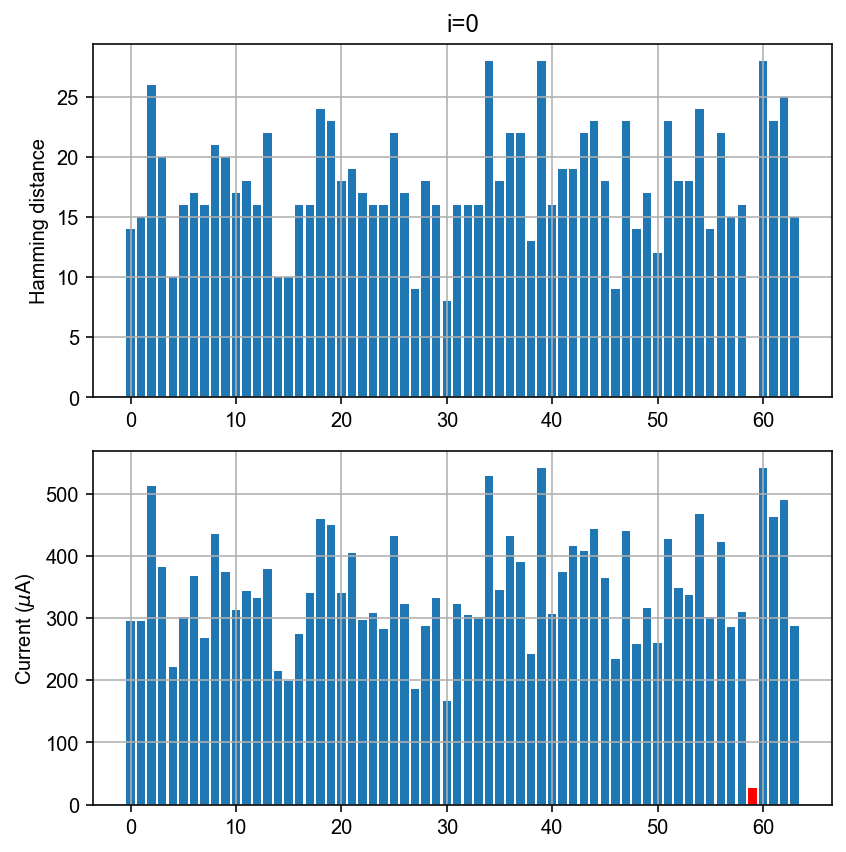

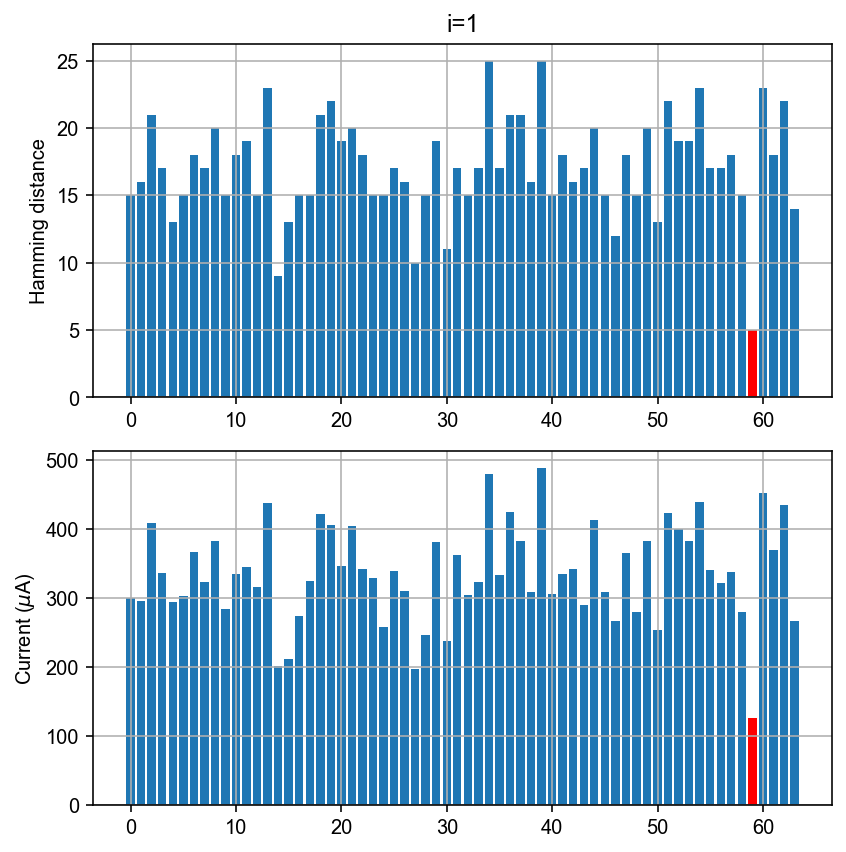

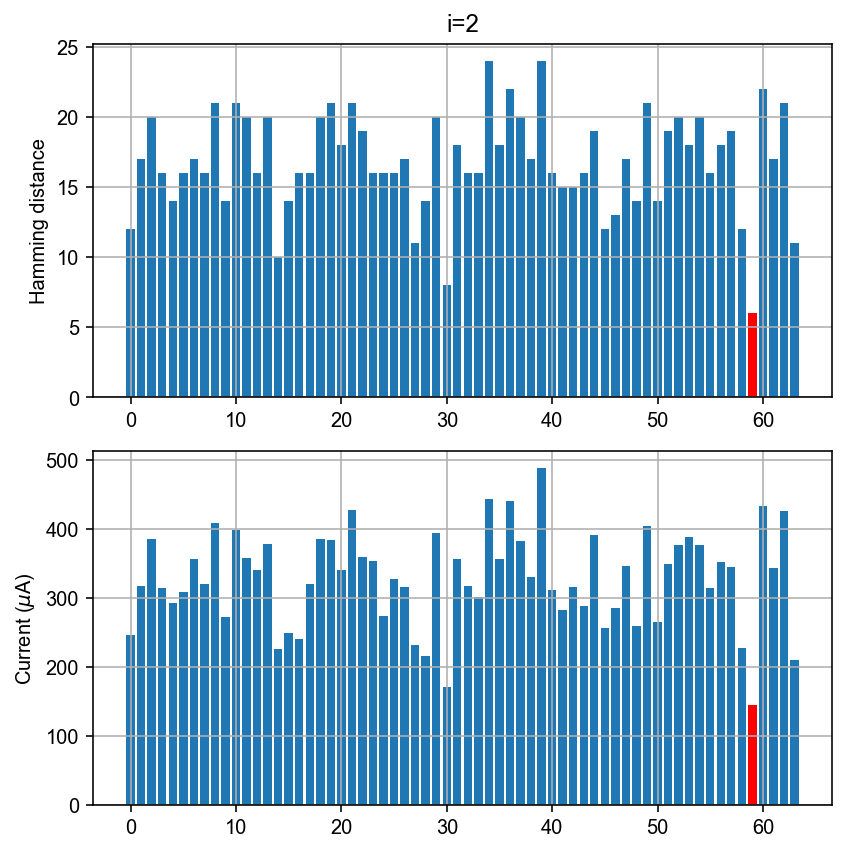

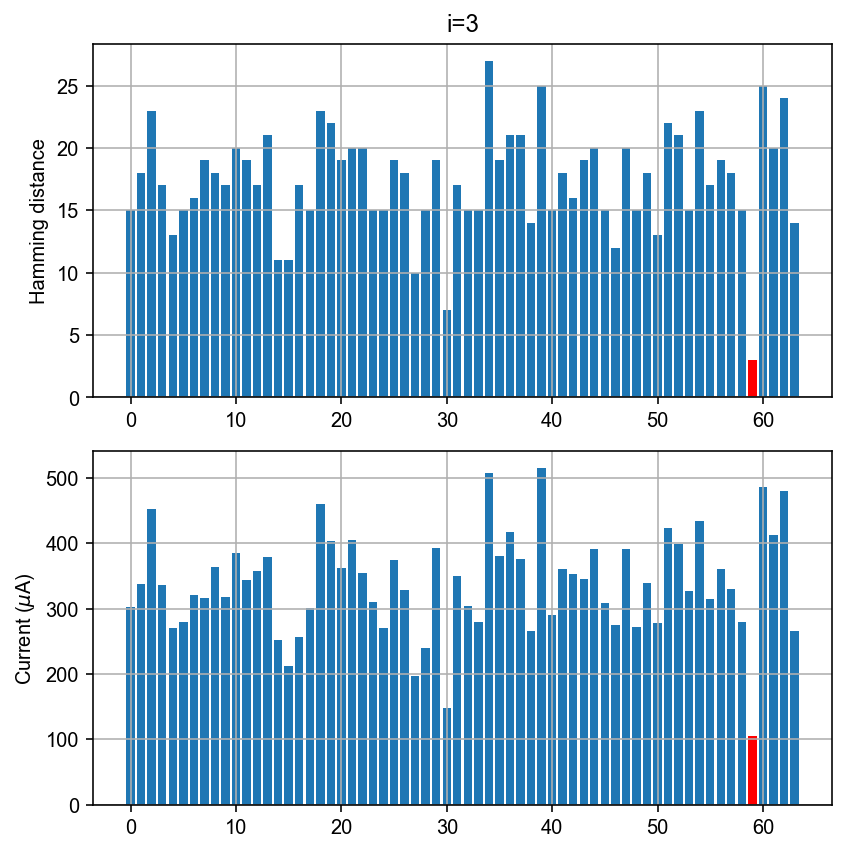

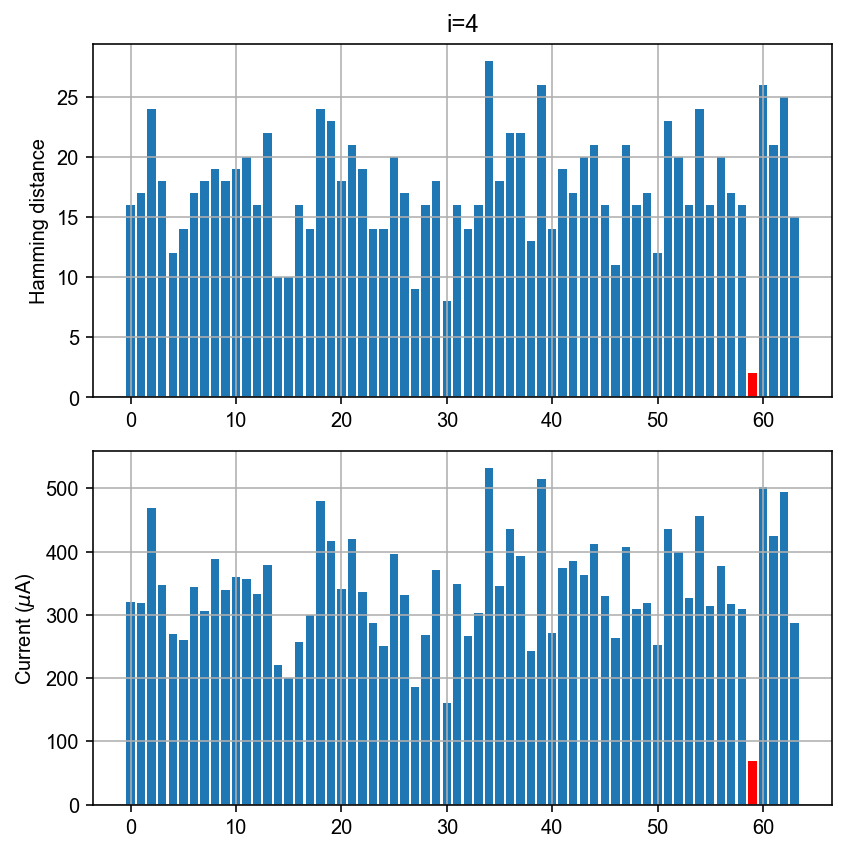

...

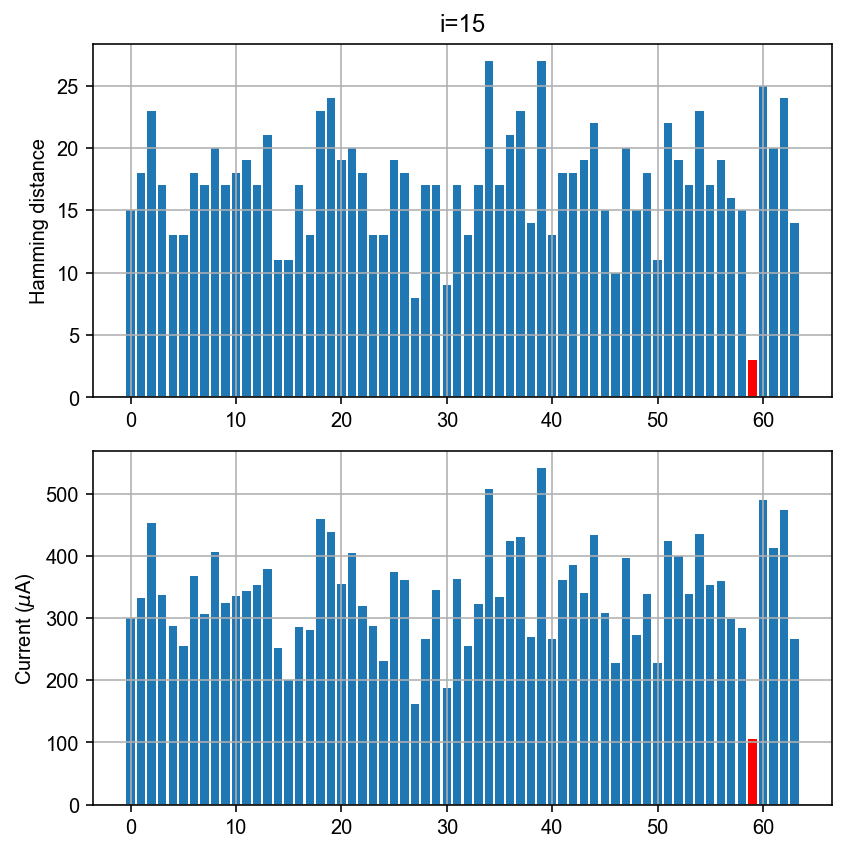

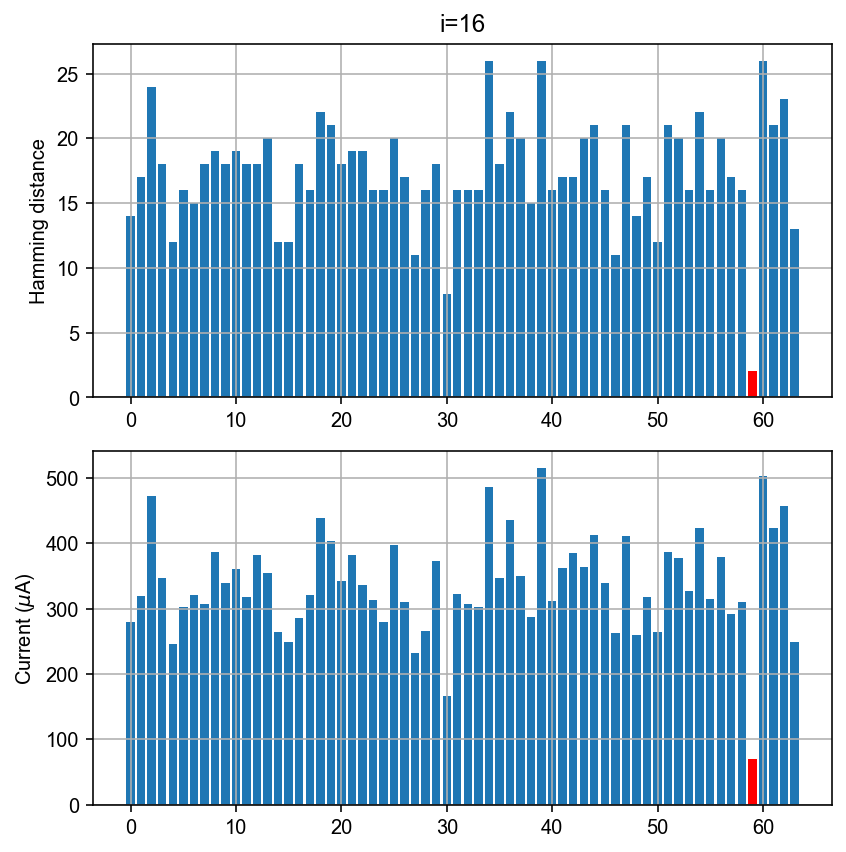

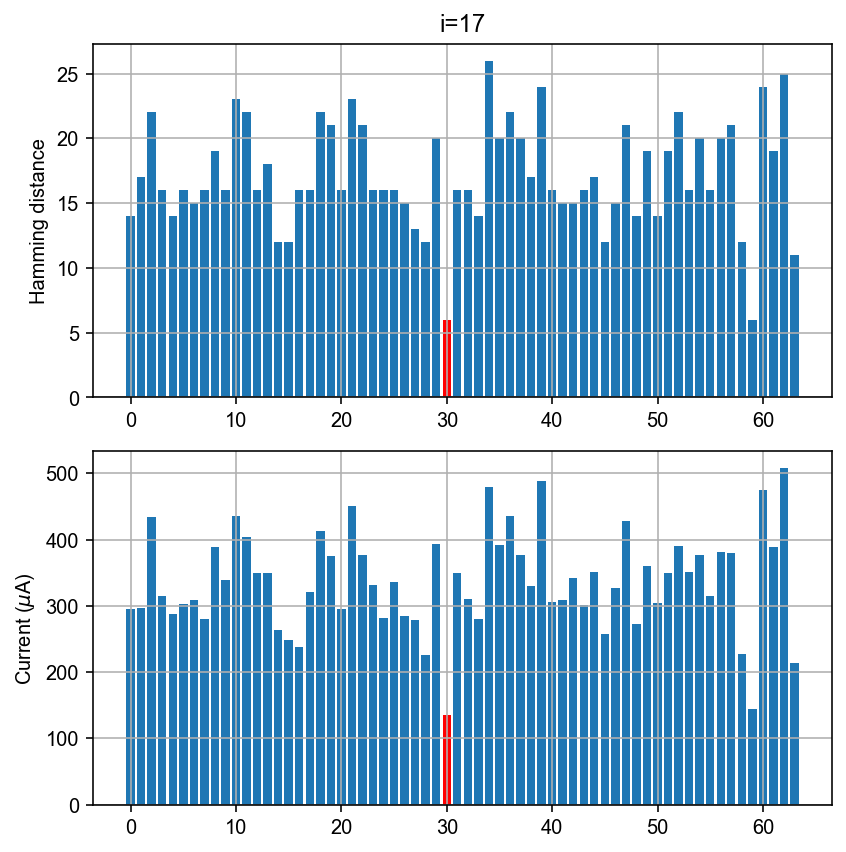

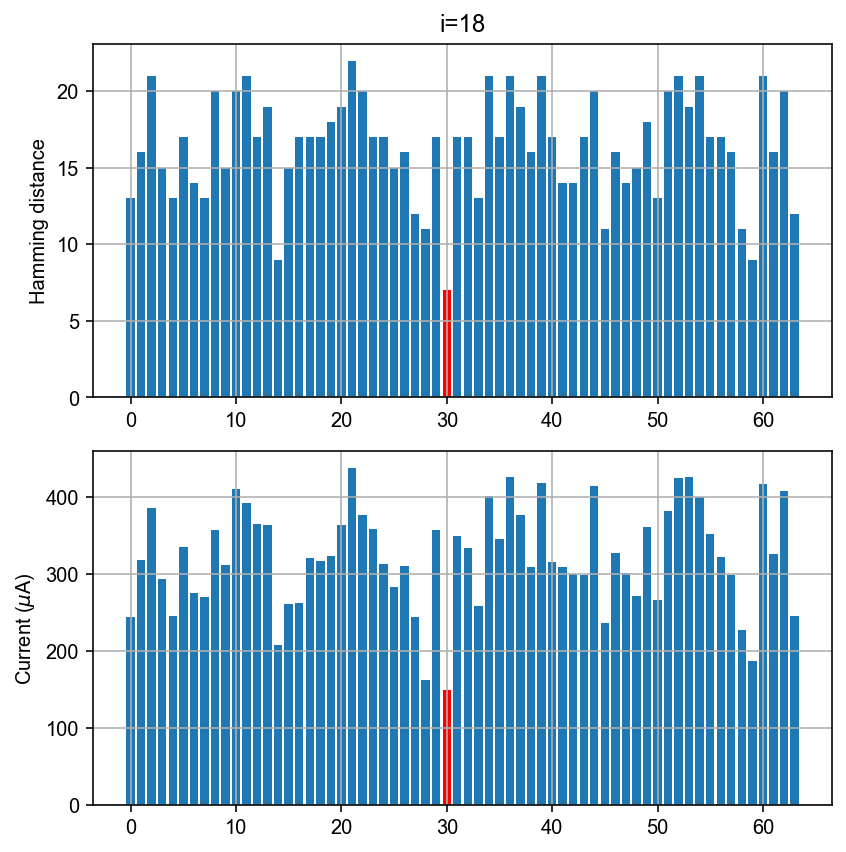

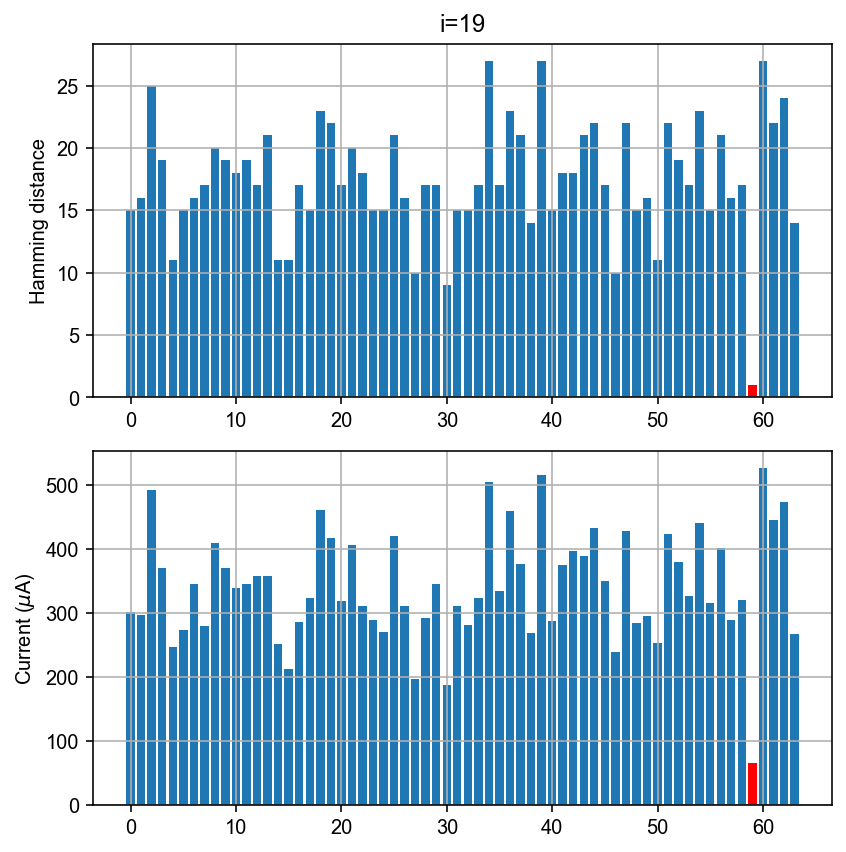

In [91]:
fsize = (6,6)
output_curr = output_cor * 0.2 * 1e6
    
for i in range(500):
    plt.figure(i+1, figsize=fsize)
    plt.subplot(2,1,1)
    plt.title(f'i={i}')

    # plt.figure(1, figsize=fsize)
    plt.bar(range(64), dist[i])
    plt.bar(dist[i].argmin(), dist[i].min(), color='red')
    plt.ylabel('Hamming distance')

    plt.subplot(2,1,2)
    # plt.figure(2, figsize=fsize)
    plt.bar(range(64), output_curr[i])
    plt.bar(output_curr[i].argmin(), output_curr[i].min(), color='red')
    plt.ylabel('Current ($\mu$A)')

    plt.tight_layout()
    plt.savefig(f'distance_comp_i_{i}.svg')

/Users/canli/.virtualenvs/py37/lib/python3.7/site-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


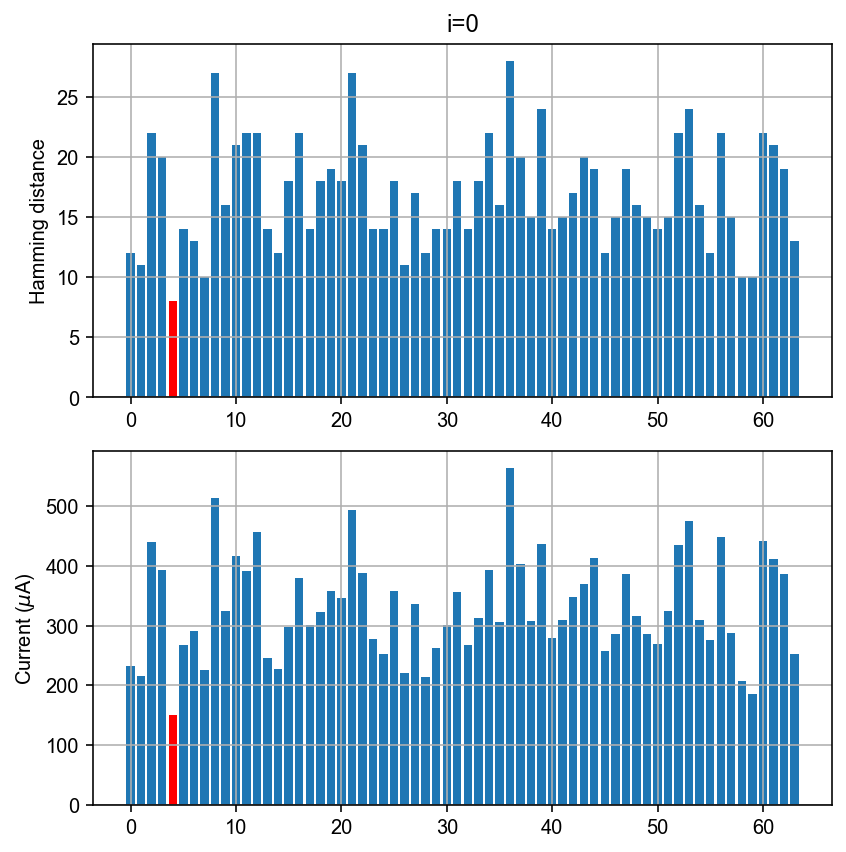

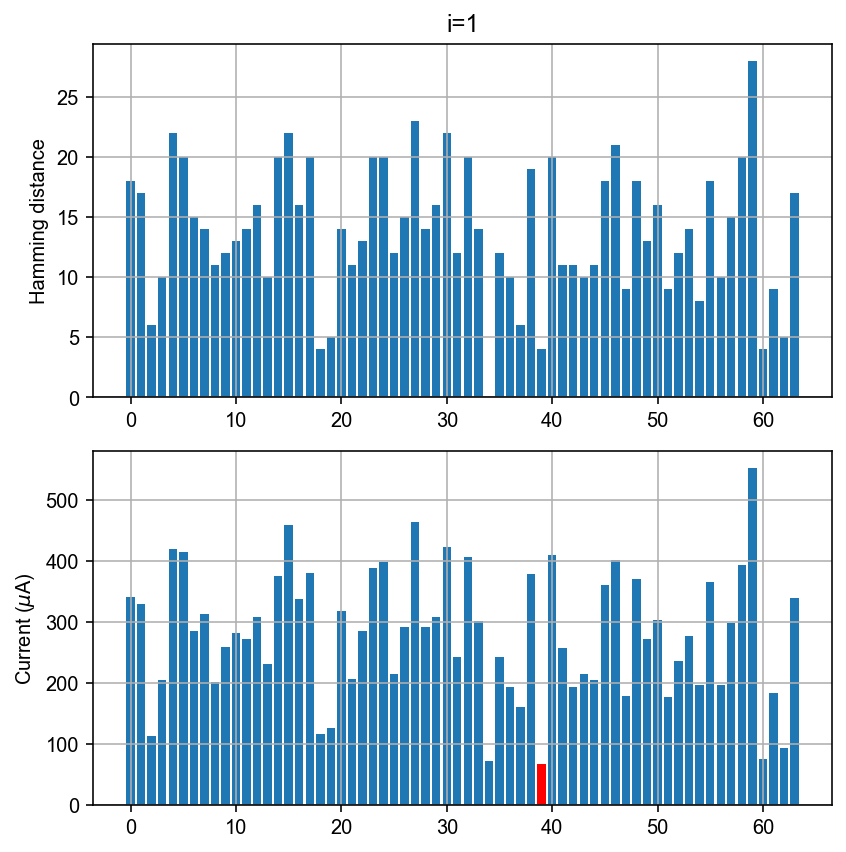

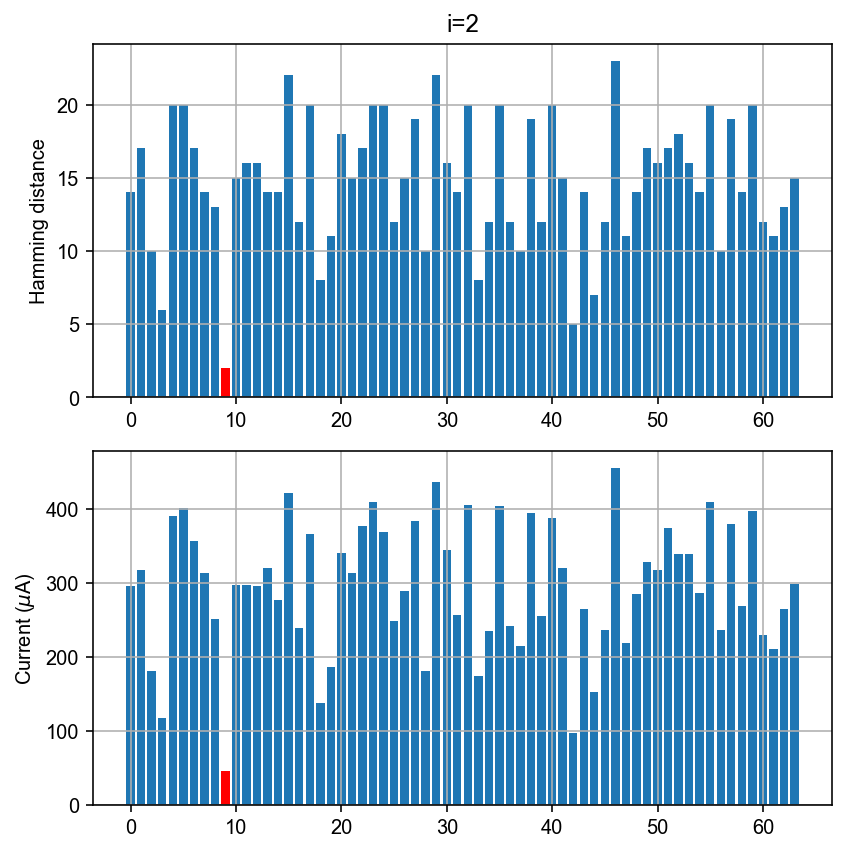

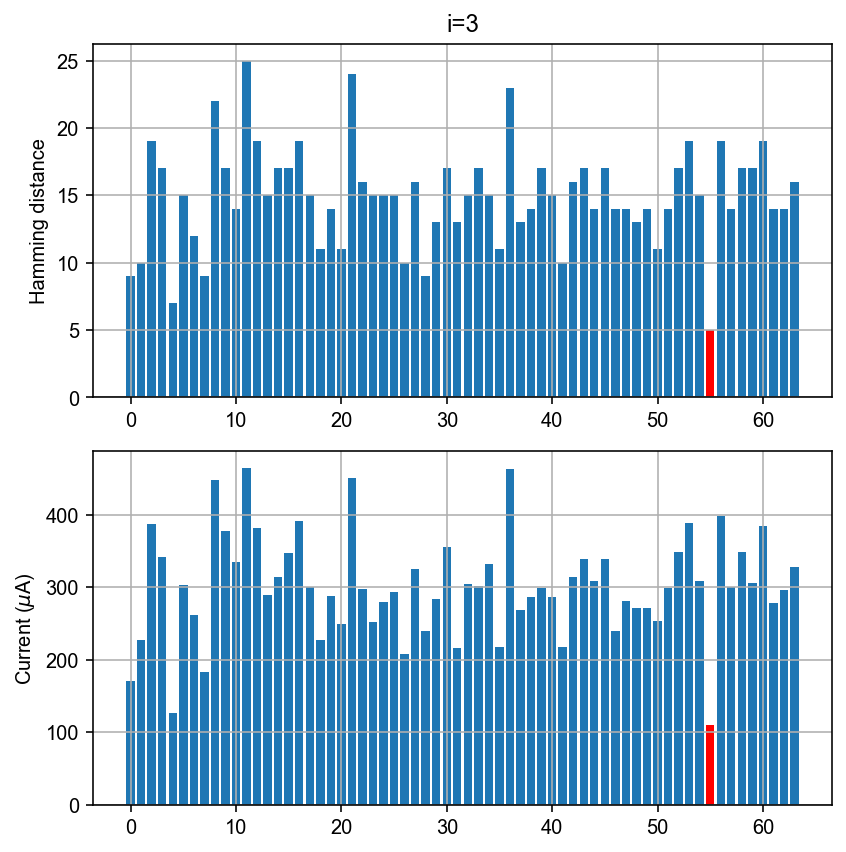

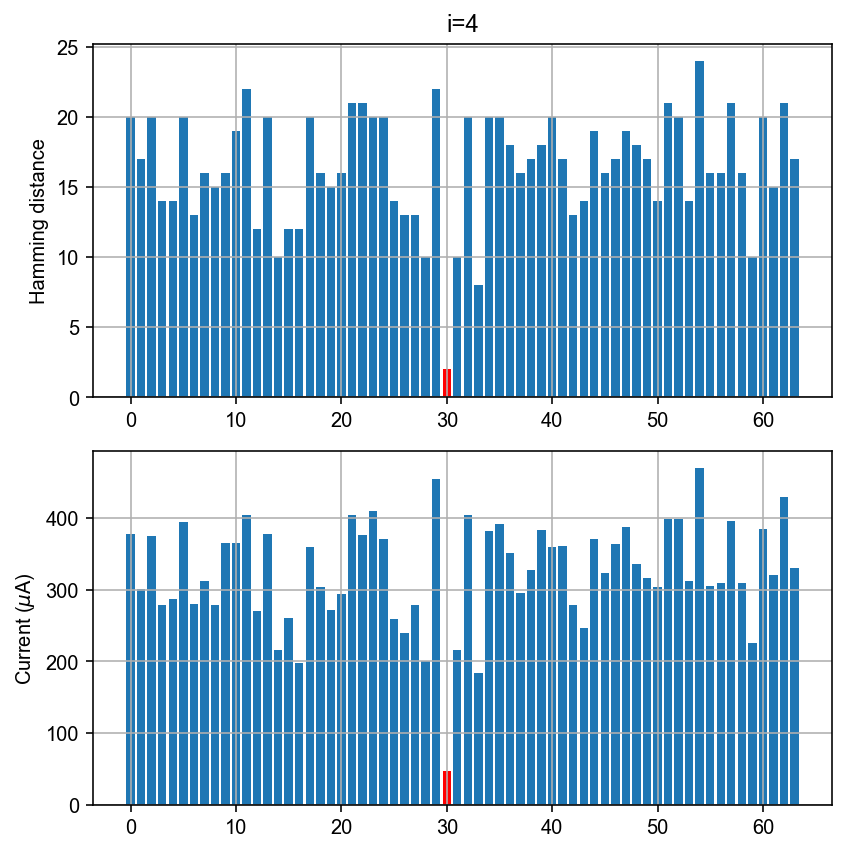

...

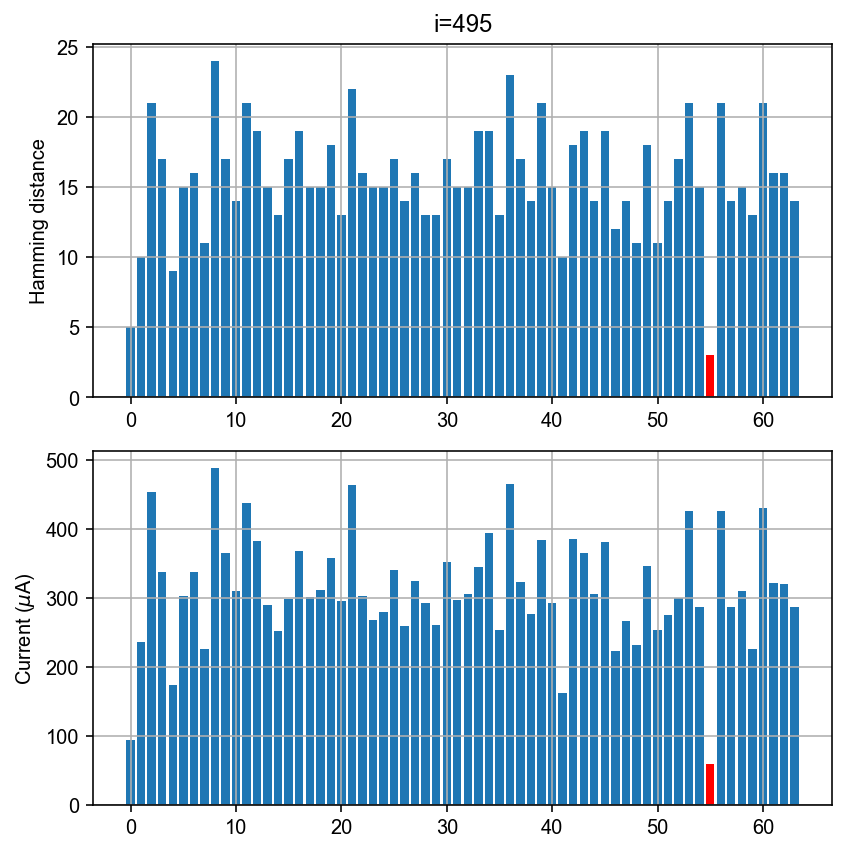

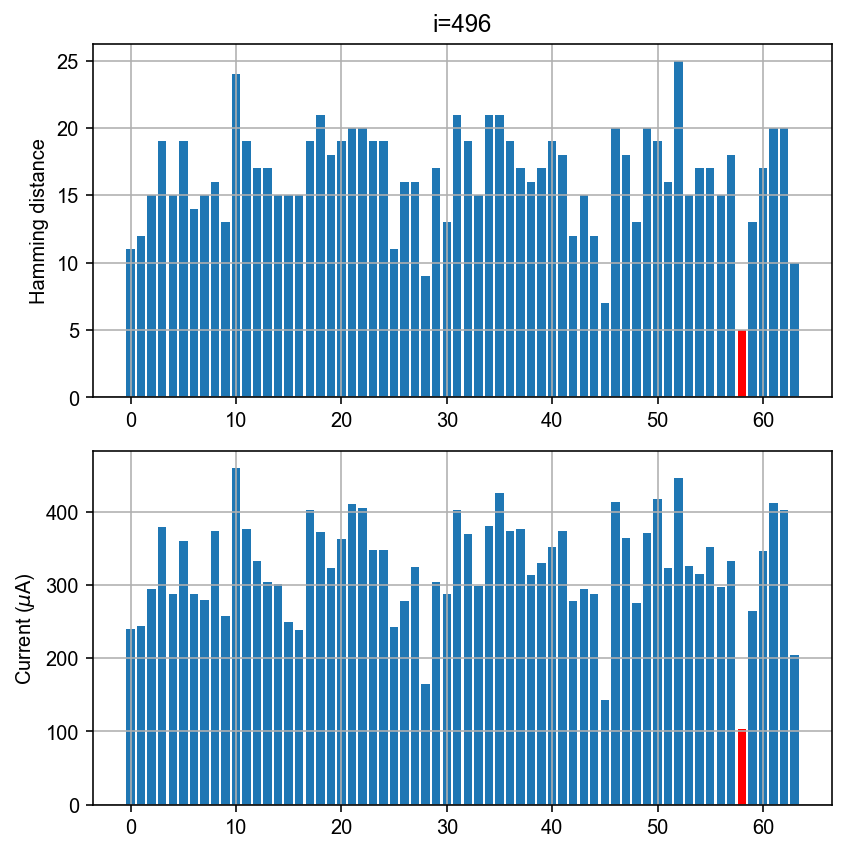

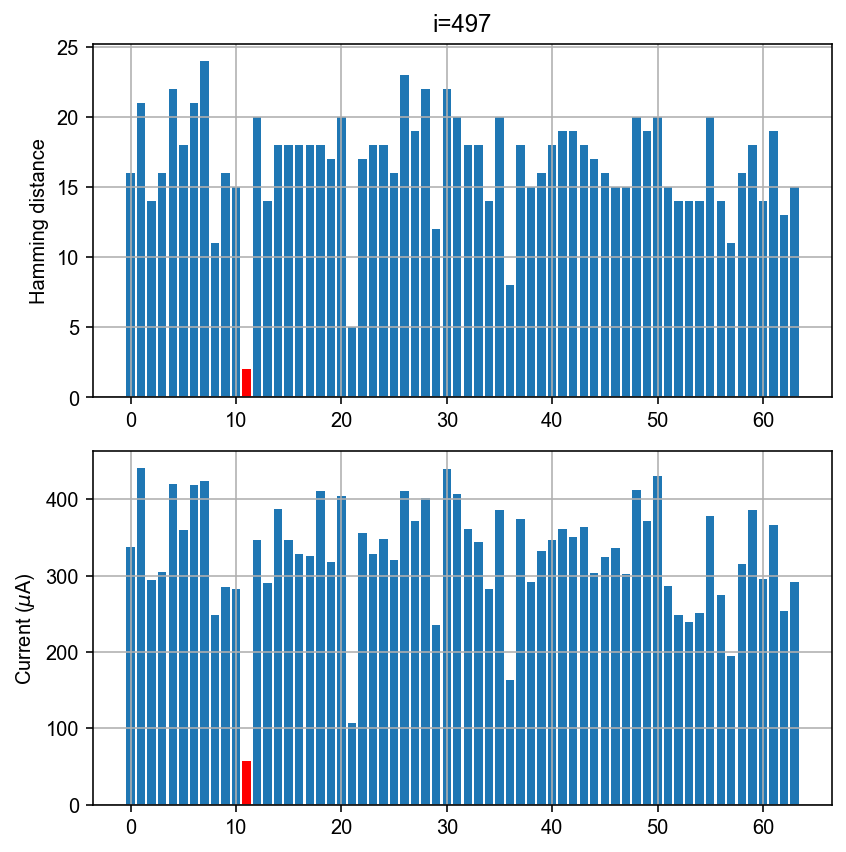

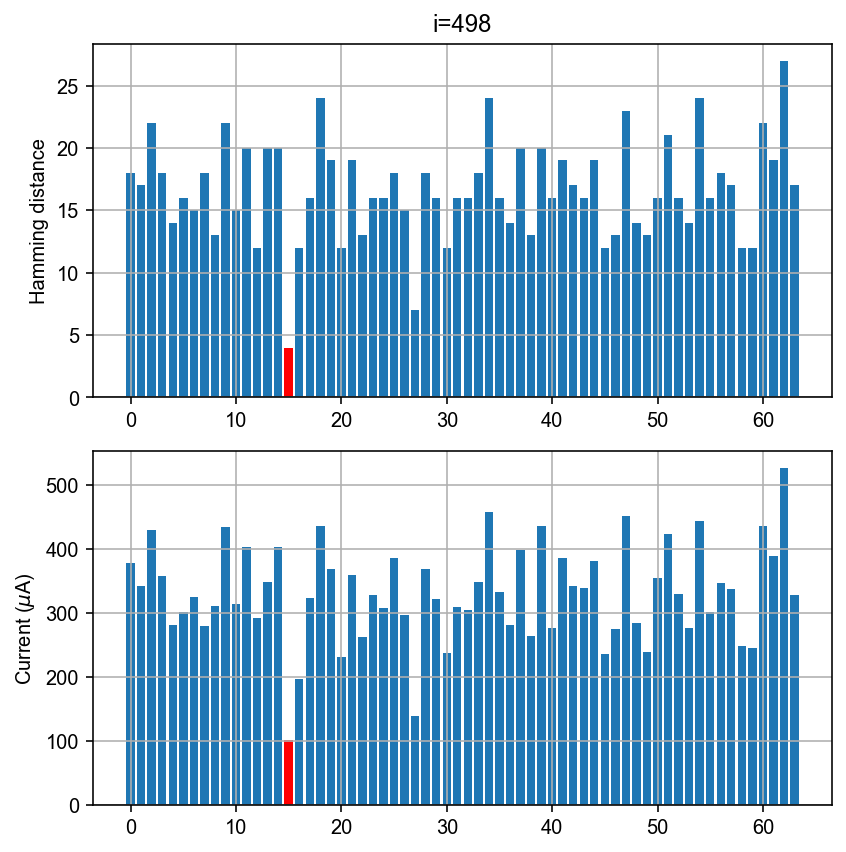

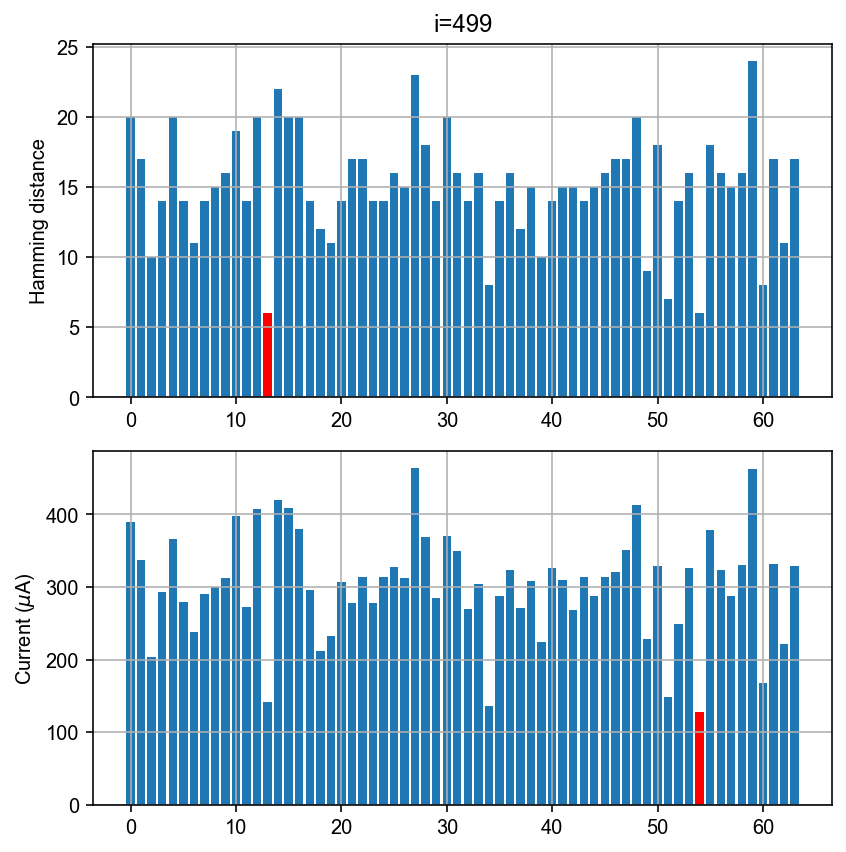

In [95]:
output_cor = lin_corr(out_dpe, lin_cor_tcam)
dist = np.array([hamming(q, hash_key) for q in qs_hash])

fsize = (6,6)
output_curr = output_cor * 0.2 * 1e6
    
for i in range(qs_hash.shape[0]):
    plt.figure(i+1, figsize=fsize)
    plt.subplot(2,1,1)
    plt.title(f'i={i}')

    # plt.figure(1, figsize=fsize)
    plt.bar(range(64), dist[i])
    plt.bar(dist[i].argmin(), dist[i].min(), color='red')
    plt.ylabel('Hamming distance')

    plt.subplot(2,1,2)
    # plt.figure(2, figsize=fsize)
    plt.bar(range(64), output_curr[i])
    plt.bar(output_curr[i].argmin(), output_curr[i].min(), color='red')
    plt.ylabel('Current ($\mu$A)')

    plt.tight_layout()
    plt.savefig(f'data/distance_comp_i_{i}.svg')

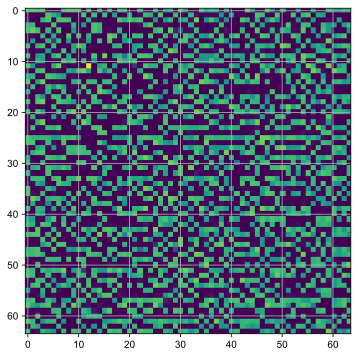

In [35]:
plt.imshow(g)

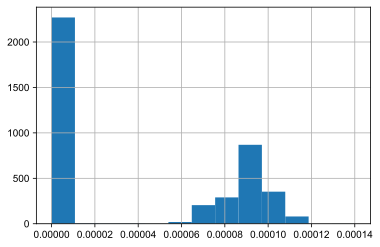

In [49]:
_ = plt.hist(g.reshape(-1), 13)